## Mask Wearing Detection - Transfer Learning on SOTA ScaledYOLOv4 model

* Download mask detection data
* Setup ScaledYOLOv4 Training configuration
* Train model
* Evaluate model training performance
* Visualize annotated training data
* Model inference on test data
* Visualize model inference results
* Evaluate model performance on test data


### Install Model Dependencies

In [1]:
!git clone -b yolov4-large https://github.com/roboflow-ai/ScaledYOLOv4.git  # clone the yolov4-large branch of the open-source ScaledYOLOv4 repo
# Didn't clone the original Wong Kin Yiu's repo - https://github.com/WongKinYiu/ScaledYOLOv4 because it has an issue on runtime with leaf variable.
# Scaled YOLOv4: Scaling Cross Stage Partial Network - https://arxiv.org/abs/2011.08036
%cd /content/ScaledYOLOv4/

Cloning into 'ScaledYOLOv4'...
remote: Enumerating objects: 128, done.
remote: Total 128 (delta 0), reused 0 (delta 0), pack-reused 128
Receiving objects: 100% (128/128), 338.47 KiB | 21.15 MiB/s, done.
Resolving deltas: 100% (52/52), done.
/content/ScaledYOLOv4


In [2]:
import torch
print('Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Using torch 1.8.1+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [3]:
%cd /content/
!git clone https://github.com/JunnYu/mish-cuda  #install mish activation funciton for cuda GPU
# Mish is a self-regularized non-monotonic activation function: f(x) = x tanh(softplus(x)); outperformed ReLU and Leaky ReLU - https://arxiv.org/pdf/1908.08681.pdf
%cd mish-cuda
!python setup.py build install

/content
Cloning into 'mish-cuda'...
remote: Enumerating objects: 88, done.
remote: Counting objects: 100% (88/88), done.
remote: Compressing objects: 100% (75/75), done.
remote: Total 195 (delta 7), reused 79 (delta 3), pack-reused 107
Receiving objects: 100% (195/195), 208.77 KiB | 17.40 MiB/s, done.
Resolving deltas: 100% (56/56), done.
/content/mish-cuda
/usr/lib/python3.7/distutils/extension.py:131: UserWarning: Unknown Extension options: 'headers'
  warnings.warn(msg)
running build
running build_py
creating build
creating build/lib.linux-x86_64-3.7
creating build/lib.linux-x86_64-3.7/mish_cuda
copying src/mish_cuda/__init__.py -> build/lib.linux-x86_64-3.7/mish_cuda
running egg_info
creating src/mish_cuda.egg-info
writing src/mish_cuda.egg-info/PKG-INFO
writing dependency_links to src/mish_cuda.egg-info/dependency_links.txt
writing requirements to src/mish_cuda.egg-info/requires.txt
writing top-level names to src/mish_cuda.egg-info/top_level.txt
writing manifest file 'src/mish_cu

In [4]:
!pip install -U PyYAML  # PyYAML enables reading the data file

     |████████████████████████████████| 645kB 18.2MB/s 
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


### Download Annotated Dataset 

- 1,815 640x640 Preprocessed images (required model input resolution) before augmentation
- 70% Training data (3,804 including augmentation), 20% validation (362 images) and 10% test data (183 images)

In [5]:
%cd /content

!curl -L "https://app.roboflow.com/ds/wIBsLFZkvX?key=huvnv6PNyz" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip;
# download dataset preprocessed with resizing, our Bremner team's manuel annotations, plus augmentations in Roboflow

Streaming output truncated to the last 5000 lines.
 extracting: train/images/986_jpg.rf.2de54ea32ec8ab87c25fc7c2776ee50b.jpg  
 extracting: train/images/986_jpg.rf.55b7acaf1e386e924bf3b02c99ef36f8.jpg  
 extracting: train/images/986_jpg.rf.e25cca973ff2be264267ff1443c985ce.jpg  
 extracting: train/images/988_jpg.rf.0c64b6b1ea864278bc04aab8b56a9e3e.jpg  
 extracting: train/images/988_jpg.rf.1fccc6d8c4106dd809ff497a3623f539.jpg  
 extracting: train/images/988_jpg.rf.d777cf745d214679f135a0b6dbc0c78b.jpg  
 extracting: train/images/98_jpg.rf.4659d2edfe6a3a5c02da047aa4445c2b.jpg  
 extracting: train/images/98_jpg.rf.4bf11a24109d3aa7352d02814c964f81.jpg  
 extracting: train/images/98_jpg.rf.592857399daa89c7cd065a1787645783.jpg  
 extracting: train/images/991_jpeg.rf.1fad1f629c09d20fa039312b8108a9cb.jpg  
 extracting: train/images/991_jpeg.rf.2641ee237d252056f355e06bb98d7af1.jpg  
 extracting: train/images/991_jpeg.rf.e74fe854ba0cf44e59dfa22896edb9e9.jpg  
 extracting: train/images/992_jpg.rf.

In [6]:
%cat data.yaml # view the dataset YAML file

train: ../train/images
val: ../valid/images

nc: 2
names: ['mask', 'no-mask']

In [7]:
%cd /content/
!wget https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/test.yaml

/content
--2021-03-31 01:11:44--  https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/test.yaml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 75 [text/plain]
Saving to: ‘test.yaml’

test.yaml           100%[===================>]      75  --.-KB/s    in 0s      

2021-03-31 01:11:44 (4.92 MB/s) - ‘test.yaml’ saved [75/75]



In [8]:
%cat test.yaml

test: ../test/images
val: ../test/images

nc: 2
names: ['mask', 'no-mask']


### View Model Configuration and Architecture

In [9]:
%cd /content/ScaledYOLOv4/models/
!wget https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/yolov4-csp-mask.yaml

/content/ScaledYOLOv4/models
--2021-03-31 01:11:48--  https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/yolov4-csp-mask.yaml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1606 (1.6K) [text/plain]
Saving to: ‘yolov4-csp-mask.yaml’

yolov4-csp-mask.yam 100%[===================>]   1.57K  --.-KB/s    in 0s      

2021-03-31 01:11:48 (41.1 MB/s) - ‘yolov4-csp-mask.yaml’ saved [1606/1606]



In [10]:
%cat /content/ScaledYOLOv4/models/yolov4-csp-mask.yaml  # change default number of classes from 80 for COCO dataset to 2 for mask detection
# tried to reduce depth and width multiples as shown later in hyperparameter tuning - performance turned out to be worse than the 1 and 1 for the default configuration

# parameters
nc: 2  # number of classes
depth_multiple: 1.0  # model depth multiple
width_multiple: 1.0  # layer channel multiple

# anchors
anchors:
  - [12,16, 19,36, 40,28]  # P3/8
  - [36,75, 76,55, 72,146]  # P4/16
  - [142,110, 192,243, 459,401]  # P5/32

# yolov4-csp backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [32, 3, 1]],  # 0
   [-1, 1, Conv, [64, 3, 2]],  # 1-P1/2
   [-1, 1, Bottleneck, [64]],
   [-1, 1, Conv, [128, 3, 2]],  # 3-P2/4
   [-1, 2, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 5-P3/8
   [-1, 8, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 7-P4/16
   [-1, 8, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]], # 9-P5/32
   [-1, 4, BottleneckCSP, [1024]],  # 10
  ]

# yolov4-csp head
# na = len(anchors[0])
head:
  [[-1, 1, SPPCSP, [512]], # 11
   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [8, 1, Conv, [256, 1, 1]], # route backbone P4
   [[-1, -2], 1, Concat, [1]],
   [-1, 2, Bottl

In [11]:
%cat /content/ScaledYOLOv4/data/hyp.finetune.yaml  #view the fine-tuned hyperparameters on the COCO dataset

lr0: 0.01  # initial learning rate (SGD=1E-2, Adam=1E-3)
momentum: 0.937  # SGD momentum/Adam beta1
weight_decay: 0.0005  # optimizer weight decay 5e-4
giou: 0.05  # GIoU loss gain
cls: 0.5  # cls loss gain
cls_pw: 1.0  # cls BCELoss positive_weight
obj: 1.0  # obj loss gain (scale with pixels)
obj_pw: 1.0  # obj BCELoss positive_weight
iou_t: 0.20  # IoU training threshold
anchor_t: 4.0  # anchor-multiple threshold
fl_gamma: 0.0  # focal loss gamma (efficientDet default gamma=1.5)
hsv_h: 0.015  # image HSV-Hue augmentation (fraction)
hsv_s: 0.7  # image HSV-Saturation augmentation (fraction)
hsv_v: 0.4  # image HSV-Value augmentation (fraction)
degrees: 0.0  # image rotation (+/- deg)
translate: 0.5  # image translation (+/- fraction)
scale: 0.8  # image scale (+/- gain)
shear: 0.0  # image shear (+/- deg)
perspective: 0.0  # image perspective (+/- fraction), range 0-0.001
flipud: 0.0  # image flip up-down (probability)
fliplr: 0.5  # image flip left-right (probability)
mixup: 0.2  # 

### Train ScaledYOLOv4 Mask Detector

Parameters:
- **img:** input image size
- **batch:** batch size
- **epochs:** number of training epochs
- **data:** path in yaml file
- **cfg:** model configuration
- **weights:** path to weights
- **hyp:** hyperparameters applied in model
- **name:** name for the model results file
- **nosave:** True to only save the final checkpoint
- **cache:** cache images for faster training

Hyperparameters in hyp file:
- **lr0:** initial learning rate
- **momentum**
- **weight_decay**
- **giou**
- **full list in hyp file**

In [ ]:
# record time for training ScaledYOLOv4-csp on 10 epochs
# train the base model


%%time
%cd /content/ScaledYOLOv4/
!python train.py --img 640 --batch 8 --epochs 10 --data '../data.yaml' --cfg ./models/yolov4-csp-mask.yaml --weights weights/yolov4-csp.weights  --hyp data/hyp.finetune.yaml  --name yolov4-csp-results  --nosave  --cache
# Adam is False, resulted in better performance than when adam=True
# Can do hyperparameter evolution with --evolve, which uses genetic algorithm for optimization.  However, it's set at default 100 iterations of the best scenario that maximizes fitness, 
# so it's too time and resources consuming to carry out on Colab free tier for this project.  
# If we were given greater dedicated GPU/TPU computing resources and more time, will certainly adopt hyperparameter evolution to find the best tuned hyperparameters. 
# Weights using pre-trained weights found on COCO dataset, better than randomly initialize using --weights ''

/content/ScaledYOLOv4
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Namespace(adam=False, batch_size=8, bucket='', cache_images=True, cfg='./models/yolov4-csp-mask.yaml', data='../data.yaml', device='', epochs=10, evolve=False, global_rank=-1, hyp='data/hyp.finetune.yaml', img_size=[640, 640], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov4-csp-results', noautoanchor=False, nosave=True, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=8, weights='weights/yolov4-csp.weights', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2021-03-25 23:38:17.875908: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Hyperparameters {'lr0': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma': 0

**Hyperparameter Tuning**
- Reduce model depth and width parameter values in model configuration

In [13]:
%cd /content/ScaledYOLOv4/models/
!wget https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/yolov4-csp-mask-v2.yaml

/content/ScaledYOLOv4/models
--2021-03-31 01:12:22--  https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/yolov4-csp-mask-v2.yaml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1607 (1.6K) [text/plain]
Saving to: ‘yolov4-csp-mask-v2.yaml.1’

yolov4-csp-mask-v2. 100%[===================>]   1.57K  --.-KB/s    in 0s      

2021-03-31 01:12:22 (11.5 MB/s) - ‘yolov4-csp-mask-v2.yaml.1’ saved [1607/1607]



In [14]:
%cat /content/ScaledYOLOv4/models/yolov4-csp-mask-v2.yaml  # modified model configuration with 0.33 of default depth and 0.5 of default width

# parameters
nc: 2  # number of classes
depth_multiple: 0.33 # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [12,16, 19,36, 40,28]  # P3/8
  - [36,75, 76,55, 72,146]  # P4/16
  - [142,110, 192,243, 459,401]  # P5/32

# yolov4-csp backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [32, 3, 1]],  # 0
   [-1, 1, Conv, [64, 3, 2]],  # 1-P1/2
   [-1, 1, Bottleneck, [64]],
   [-1, 1, Conv, [128, 3, 2]],  # 3-P2/4
   [-1, 2, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 5-P3/8
   [-1, 8, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 7-P4/16
   [-1, 8, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]], # 9-P5/32
   [-1, 4, BottleneckCSP, [1024]],  # 10
  ]

# yolov4-csp head
# na = len(anchors[0])
head:
  [[-1, 1, SPPCSP, [512]], # 11
   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [8, 1, Conv, [256, 1, 1]], # route backbone P4
   [[-1, -2], 1, Concat, [1]],
   [-1, 2, Bott

In [ ]:
%%time

%cd /content/ScaledYOLOv4/
# hyperparameter tuning - changed architecture cfg to 0.33 of the initial depth and 0.50 of the inital width or layer channels, versus the base model
# performance is worse than base model
!python train.py --img 640 --batch 8 --epochs 10 --data '../data.yaml' --cfg ./models/yolov4-csp-mask-v2.yaml --weights weights/yolov4-csp.weights  --hyp data/hyp.finetune.yaml  --name yolov4-csp-results  --nosave  --cache

/content/ScaledYOLOv4
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Namespace(adam=False, batch_size=8, bucket='', cache_images=True, cfg='./models/yolov4-csp-mask-v2.yaml', data='../data.yaml', device='', epochs=10, evolve=False, global_rank=-1, hyp='data/hyp.finetune.yaml', img_size=[640, 640], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov4-csp-results', noautoanchor=False, nosave=True, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=8, weights='weights/yolov4-csp.weights', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2021-03-28 16:07:53.057331: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Hyperparameters {'lr0': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamma'

- Increase learning rate

In [15]:
%cd /content/ScaledYOLOv4/data/
!wget https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/hyp.finetune-mask.yaml

/content/ScaledYOLOv4/data
--2021-03-31 01:12:38--  https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/hyp.finetune-mask.yaml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1026 (1.0K) [text/plain]
Saving to: ‘hyp.finetune-mask.yaml’

hyp.finetune-mask.y 100%[===================>]   1.00K  --.-KB/s    in 0s      

2021-03-31 01:12:38 (49.3 MB/s) - ‘hyp.finetune-mask.yaml’ saved [1026/1026]



In [16]:
%cat /content/ScaledYOLOv4/data/hyp.finetune-mask.yaml  #view the modified hyperparameters which has changed default initial learning rate from 0.01 to 0.03

lr0: 0.03  # initial learning rate (SGD=1E-2, Adam=1E-3)
momentum: 0.937  # SGD momentum/Adam beta1
weight_decay: 0.0005  # optimizer weight decay 5e-4
giou: 0.05  # GIoU loss gain
cls: 0.5  # cls loss gain
cls_pw: 1.0  # cls BCELoss positive_weight
obj: 1.0  # obj loss gain (scale with pixels)
obj_pw: 1.0  # obj BCELoss positive_weight
iou_t: 0.20  # IoU training threshold
anchor_t: 4.0  # anchor-multiple threshold
fl_gamma: 0.0  # focal loss gamma (efficientDet default gamma=1.5)
hsv_h: 0.015  # image HSV-Hue augmentation (fraction)
hsv_s: 0.7  # image HSV-Saturation augmentation (fraction)
hsv_v: 0.4  # image HSV-Value augmentation (fraction)
degrees: 0.0  # image rotation (+/- deg)
translate: 0.5  # image translation (+/- fraction)
scale: 0.8  # image scale (+/- gain)
shear: 0.0  # image shear (+/- deg)
perspective: 0.0  # image perspective (+/- fraction), range 0-0.001
flipud: 0.0  # image flip up-down (probability)
fliplr: 0.5  # image flip left-right (probability)
mixup: 0.2  # 

In [ ]:
%%time

%cd /content/ScaledYOLOv4/
# performance improved with learning rate of 0.03
# hyperparameter tuning - increased initial learning rate from 0.01 to 0.03 in hyp.finetune-mask.yaml file.  Tried changing to 0.1, but the lr was too large and went off range
# tried changing learning rate to 0.02, 0.04, 0.06 and performance was worse.  When learning rate was 0.05, the performance was comparable - the mAP0.5 is 0.678 for 10 epochs versus mAP of 0.674 when learning rate was 0.03.
# tried to reduce initial learning rate from 0.01 to 0.001, and the model was learning too slowly, so didn't go with this option
!python train.py --img 640 --batch 8 --epochs 10 --data '../data.yaml' --cfg ./models/yolov4-csp-mask.yaml --weights weights/yolov4-csp.weights  --hyp data/hyp.finetune-mask.yaml  --name yolov4-csp-results  --nosave  --cache

/content/ScaledYOLOv4
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Namespace(adam=False, batch_size=8, bucket='', cache_images=True, cfg='./models/yolov4-csp-mask.yaml', data='../data.yaml', device='', epochs=10, evolve=False, global_rank=-1, hyp='data/hyp.finetune-mask.yaml', img_size=[640, 640], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov4-csp-results', noautoanchor=False, nosave=True, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=8, weights='weights/yolov4-csp.weights', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2021-03-27 14:25:16.289625: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Hyperparameters {'lr0': 0.03, 'momentum': 0.937, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_gamm

- Increase momentum to 0.95 when learning rate is 0.03

In [17]:
%cd /content/ScaledYOLOv4/data/
!wget https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/hyp.finetune-mask-v2.yaml

/content/ScaledYOLOv4/data
--2021-03-31 01:12:55--  https://raw.githubusercontent.com/dkalantari/MMAI894MaskDetection/main/Notebooks/hyp.finetune-mask-v2.yaml
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1025 (1.0K) [text/plain]
Saving to: ‘hyp.finetune-mask-v2.yaml’

hyp.finetune-mask-v 100%[===================>]   1.00K  --.-KB/s    in 0s      

2021-03-31 01:12:55 (63.9 MB/s) - ‘hyp.finetune-mask-v2.yaml’ saved [1025/1025]



In [18]:
%cat /content/ScaledYOLOv4/data/hyp.finetune-mask-v2.yaml  #view the modified hyperparameters which has changed default momentum from 0.937 to 0.95, and default initial learning rate from 0.01 to 0.03

lr0: 0.03  # initial learning rate (SGD=1E-2, Adam=1E-3)
momentum: 0.95  # SGD momentum/Adam beta1
weight_decay: 0.0005  # optimizer weight decay 5e-4
giou: 0.05  # GIoU loss gain
cls: 0.5  # cls loss gain
cls_pw: 1.0  # cls BCELoss positive_weight
obj: 1.0  # obj loss gain (scale with pixels)
obj_pw: 1.0  # obj BCELoss positive_weight
iou_t: 0.20  # IoU training threshold
anchor_t: 4.0  # anchor-multiple threshold
fl_gamma: 0.0  # focal loss gamma (efficientDet default gamma=1.5)
hsv_h: 0.015  # image HSV-Hue augmentation (fraction)
hsv_s: 0.7  # image HSV-Saturation augmentation (fraction)
hsv_v: 0.4  # image HSV-Value augmentation (fraction)
degrees: 0.0  # image rotation (+/- deg)
translate: 0.5  # image translation (+/- fraction)
scale: 0.8  # image scale (+/- gain)
shear: 0.0  # image shear (+/- deg)
perspective: 0.0  # image perspective (+/- fraction), range 0-0.001
flipud: 0.0  # image flip up-down (probability)
fliplr: 0.5  # image flip left-right (probability)
mixup: 0.2  # i

In [ ]:
%%time

%cd /content/ScaledYOLOv4/
# best performance scenario
# hyperparameter tuning - increased momentum from 0.937 to 0.95.  Tried to decrease momentum to 0.85 and the performance was worse. 
# hyperparameter tuning - set initial learning rate at 0.03
!python train.py --img 640 --batch 8 --epochs 15 --data '../data.yaml' --cfg ./models/yolov4-csp-mask.yaml --weights weights/yolov4-csp.weights  --hyp data/hyp.finetune-mask-v2.yaml  --name yolov4-csp-results  --nosave  --cache

/content/ScaledYOLOv4
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Namespace(adam=False, batch_size=8, bucket='', cache_images=True, cfg='./models/yolov4-csp-mask.yaml', data='../data.yaml', device='', epochs=15, evolve=False, global_rank=-1, hyp='data/hyp.finetune-mask-v2.yaml', img_size=[640, 640], local_rank=-1, logdir='runs/', multi_scale=False, name='yolov4-csp-results', noautoanchor=False, nosave=True, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=8, weights='weights/yolov4-csp.weights', world_size=1)
Start Tensorboard with "tensorboard --logdir runs/", view at http://localhost:6006/
2021-03-27 18:29:52.377045: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Hyperparameters {'lr0': 0.03, 'momentum': 0.95, 'weight_decay': 0.0005, 'giou': 0.05, 'cls': 0.5, 'cls_pw': 1.0, 'obj': 1.0, 'obj_pw': 1.0, 'iou_t': 0.2, 'anchor_t': 4.0, 'fl_ga

### Evaluate Model Training Performance

Review Tensorboard metrics on training losses and performance

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs  # logfile is saved in the folder "runs"

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 2187), started 2:20:47 ago. (Use '!kill 2187' to kill it.)

<IPython.core.display.Javascript object>

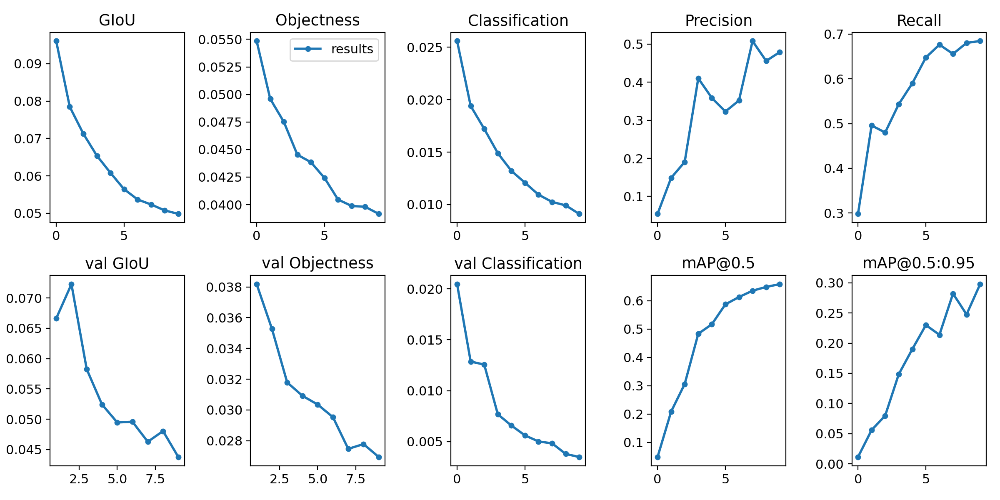

In [ ]:
from IPython.display import Image, display
display(Image('/content/ScaledYOLOv4/runs/exp3_yolov4-csp-results/results.png'))  # visualize training results from best hyperparameter-tuned scenario

### Visualize Annotated Data

Ground Truth Training Data:


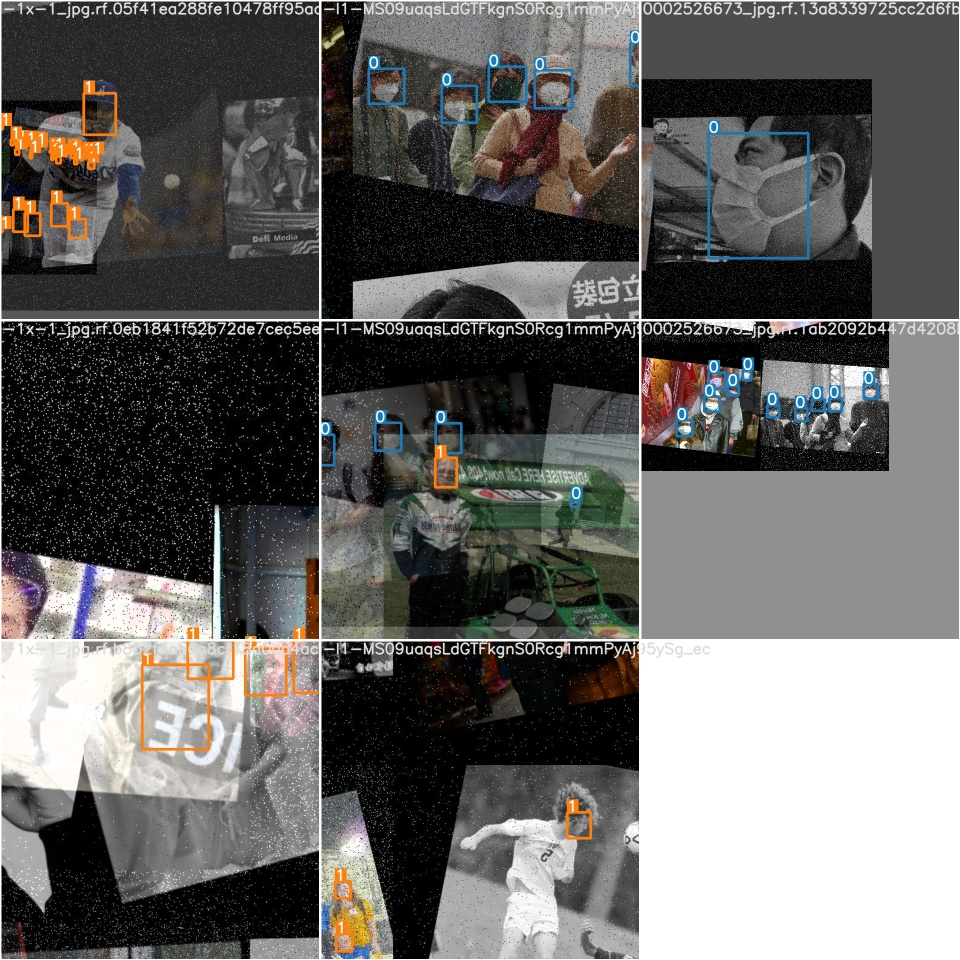

In [ ]:
print("Ground Truth Training Data:")
Image(filename='/content/ScaledYOLOv4/runs/exp3_yolov4-csp-results/train_batch0.jpg', width=900)  # show annotated ground truth for training data

Ground Truth Testing Data:


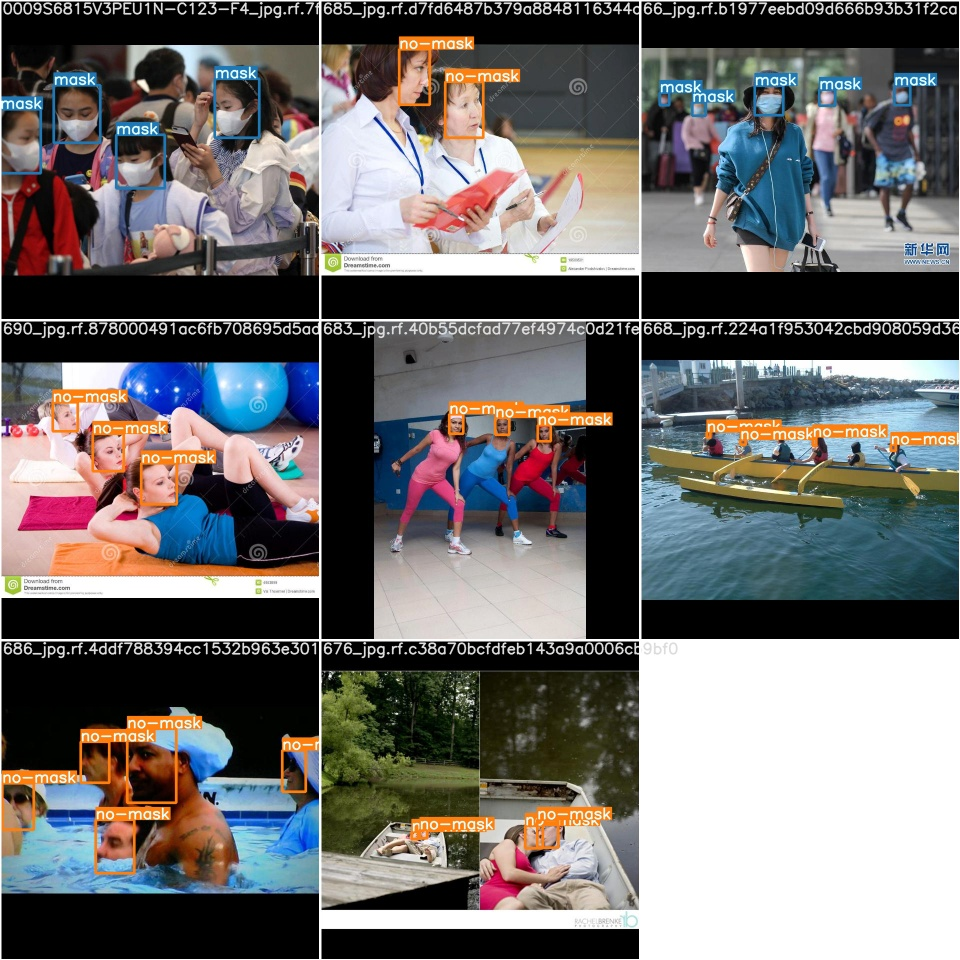

In [ ]:
print("Ground Truth Testing Data:")
Image(filename='/content/ScaledYOLOv4/runs/exp3_yolov4-csp-results/test_batch0_gt.jpg', width=900)  # view testing ground truth examples

### Inference Using Trained Weights
Inference prediction using trained final checkpoint on test data images in the `test/images` folder.

In [ ]:
%ls runs/  # list files for trained weights that're saved in weights folder

exp0_yolov4-csp-results/  exp2_yolov4-csp-results/  exp4_yolov4-csp-results/
exp1_yolov4-csp-results/  exp3_yolov4-csp-results/  exp5_yolov4-csp-results/


In [ ]:
%ls ./runs/exp3_yolov4-csp-results/weights  # list weights for the best hyperparameter-tuned scenario

best_yolov4-csp-results.pt        last_yolov4-csp-results.pt
best_yolov4-csp-results_strip.pt  last_yolov4-csp-results_strip.pt
last_009.pt


In [ ]:
%cd /content/ScaledYOLOv4/
!python detect.py --weights ./runs/exp3_yolov4-csp-results/weights/best_yolov4-csp-results.pt --img 640 --conf 0.4 --source ../test/images  
# use the best weights from the best fined-tuned scenario for inference

/content/ScaledYOLOv4
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=640, iou_thres=0.5, output='inference/output', save_txt=False, source='../test/images', update=False, view_img=False, weights=['./runs/exp4_yolov4-csp-results/weights/best_yolov4-csp-results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Fusing layers... Model Summary: 235 layers, 5.24759e+07 parameters, 5.04494e+07 gradients
image 1/183 /content/test/images/0_Concern-In-China-As-Mystery-Virus-Spreads_jpg.rf.6a92274a43b7299758b7936a2dd51d70.jpg: 640x640 2 masks, Done. (0.039s)
image 2/183 /content/test/images/1018_jpg.rf.99161bb46022b4acf1ca882e1a3f6f63.jpg: 640x640 5 masks, Done. (0.038s)
image 3/183 /content/test/images/101_jpg.rf.048359bf7d5711a875ade59399498cee.jpg: 640x640 1 masks, 6 no-masks, Done. (0.027s)
image 4/183 /content/test/images/1027_jpg.rf.f7478becdfb264312a8875db3e425d53.jpg: 640x640 1 masks, Done. (0.027s)
image

In [ ]:
import os
from IPython.display import Image, display
import random

1239_jpg.rf.c5e40c94bbdd85bbaa975b8253dced3b.jpg


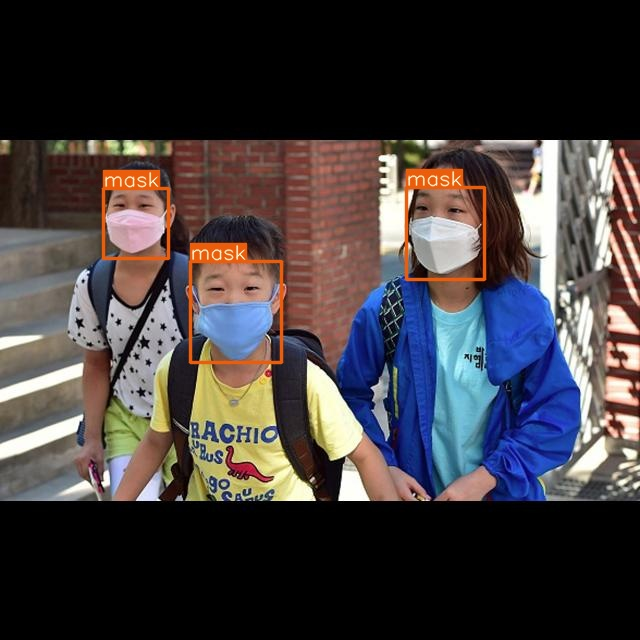

In [ ]:
filename = random.choice(os.listdir('./inference/output/'))
print(filename)
Image('./inference/output/' + filename)  # view a randomly selected reference image on test data

 - **Evaluate Inference Performance on Test Data**

In [ ]:
%cd /content/ScaledYOLOv4/

/content/ScaledYOLOv4


In [ ]:
!python test.py --weights ./runs/exp3_yolov4-csp-results/weights/best_yolov4-csp-results.pt --img 640 --batch 8 --conf 0.001 --data '../test.yaml'  # use best weights for inference performance

Namespace(augment=False, batch_size=8, conf_thres=0.001, data='../test.yaml', device='', img_size=640, iou_thres=0.65, merge=False, save_json=False, save_txt=False, single_cls=False, task='val', verbose=False, weights=['./runs/exp4_yolov4-csp-results/weights/best_yolov4-csp-results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Fusing layers... Model Summary: 235 layers, 5.24759e+07 parameters, 5.04494e+07 gradients
Scanning labels ../test/labels.cache (181 found, 0 missing, 2 empty, 0 duplicate, for 183 images): 100% 183/183 [00:00<00:00, 15091.87it/s]
               Class      Images     Targets           P           R      mAP@.5  mAP@.5:.95: 100% 23/23 [00:04<00:00,  4.78it/s]
                 all         183    1.12e+03       0.474       0.776       0.733       0.318
Speed: 16.7/1.8/18.5 ms inference/NMS/total per 640x640 image at batch-size 8


In [ ]:
import glob
from IPython.display import Image, display

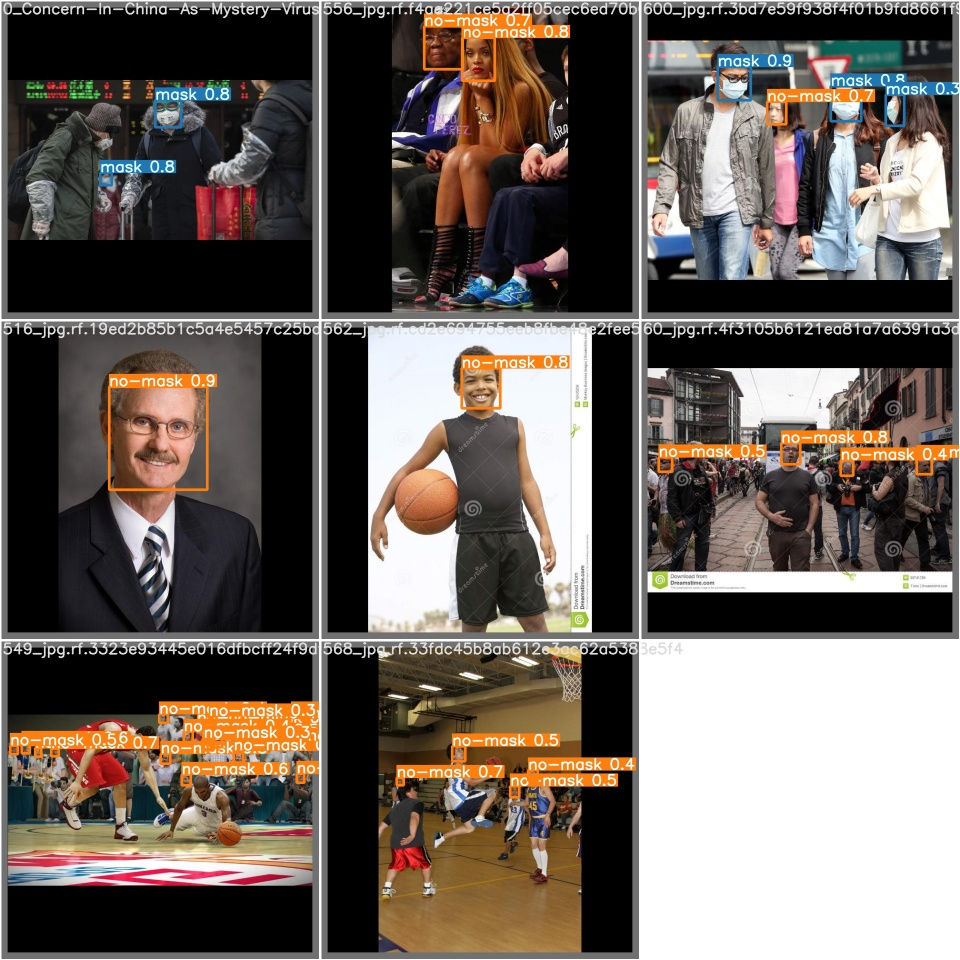

In [ ]:
Image(filename='/content/ScaledYOLOv4//test_batch0_pred.jpg', width=900)  # visualize a few more inference images on test data

# Inferencing on Video

In [21]:
%cd /content/ScaledYOLOv4/
!pwd

/content/ScaledYOLOv4
/content/ScaledYOLOv4


In [22]:
# First, download weights file for "best_yolov4_csp" model if you don't already have them (ie. skipped the 'training' phase) 

!pip install gdown

!mkdir weights
!gdown --id 1QI5MxSPzsBGoYJUSQHiGEuADRKz3re0N -O '/content/ScaledYOLOv4/weights/best_yolov4-csp-results.pt'


Downloading...
From: https://drive.google.com/uc?id=1QI5MxSPzsBGoYJUSQHiGEuADRKz3re0N
To: /content/ScaledYOLOv4/weights/best_yolov4-csp-results.pt
421MB [00:12, 32.7MB/s]


In [23]:
# Download raw videos for inferencing from YouTube

!pip install youtube_dl
import youtube_dl

!youtube-dl -f 18 "https://youtu.be/YJa5iH1Y-7Y" -o '/content/video/compiled_video2.mp4'
print()
!youtube-dl -f 18 "https://youtu.be/n2nSkMjDdJU" -o '/content/video/crowd_video1.mp4'
print()
!youtube-dl -f 18 "https://youtu.be/D8lGl7GREis" -o '/content/video/group_video1.mp4'
print()


     |████████████████████████████████| 1.9MB 18.7MB/s 
[youtube] YJa5iH1Y-7Y: Downloading webpage
[youtube] YJa5iH1Y-7Y: Downloading MPD manifest
[download] Destination: /content/video/compiled_video2.mp4
[download] 100% of 2.24MiB in 00:00

[youtube] n2nSkMjDdJU: Downloading webpage
[youtube] n2nSkMjDdJU: Downloading MPD manifest
[download] Destination: /content/video/crowd_video1.mp4
[download] 100% of 3.47MiB in 00:00

[youtube] D8lGl7GREis: Downloading webpage
[youtube] D8lGl7GREis: Downloading MPD manifest
[download] Destination: /content/video/group_video1.mp4
[download] 100% of 688.16KiB in 00:00



In [22]:
!pwd

/content/ScaledYOLOv4


In [49]:
#%cd /content/ScaledYOLOv4/
!python detect.py --weights /content/ScaledYOLOv4/weights/best_yolov4-csp-results.pt --img 640 --conf 0.3 --source /content/video/crowd_video1.mp4  --noshow


# use the best weights from the best fined-tuned scenario for inference


Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.3, device='', img_size=640, iou_thres=0.5, noshow=True, output='inference/output', save_txt=False, source='/content/video/crowd_video1.mp4', update=False, view_img=False, weights=['/content/ScaledYOLOv4/weights/best_yolov4-csp-results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Fusing layers... Model Summary: 235 layers, 5.24759e+07 parameters, 5.04494e+07 gradients
video 1/1 (1/1279) /content/video/crowd_video1.mp4: video 1/1 (2/1279) /content/video/crowd_video1.mp4: video 1/1 (3/1279) /content/video/crowd_video1.mp4: video 1/1 (4/1279) /content/video/crowd_video1.mp4: video 1/1 (5/1279) /content/video/crowd_video1.mp4: video 1/1 (6/1279) /content/video/crowd_video1.mp4: video 1/1 (7/1279) /content/video/crowd_video1.mp4: video 1/1 (8/1279) /content/video/crowd_video1.mp4: video 1/1 (9/1279) /content/video/crowd_video1.mp4: video 1/1 (10/1279) /content/video/crowd_video1.

In [50]:
# Display Video in cell

from IPython.display import HTML
from base64 import b64encode
import os

# Input video path



filename = 'crowd_video1.mp4'
justname = filename.split('.')[0]


save_path = '/content/ScaledYOLOv4/inference/output/' + filename



# Compressed video path
compressed_path = '/content/video/' + justname +"_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=720 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)


In [52]:
!python detect.py --weights /content/ScaledYOLOv4/weights/best_yolov4-csp-results.pt --img 640 --conf 0.4 --source /content/video/group_video1.mp4  --noshow

#!mv  /content/ScaledYOLOv4/inference/output/group_video1.mp4 /content/video/group_video1_inf.mp4


Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=640, iou_thres=0.5, noshow=True, output='inference/output', save_txt=False, source='/content/video/group_video1.mp4', update=False, view_img=False, weights=['/content/ScaledYOLOv4/weights/best_yolov4-csp-results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Fusing layers... Model Summary: 235 layers, 5.24759e+07 parameters, 5.04494e+07 gradients
video 1/1 (1/496) /content/video/group_video1.mp4: video 1/1 (2/496) /content/video/group_video1.mp4: video 1/1 (3/496) /content/video/group_video1.mp4: video 1/1 (4/496) /content/video/group_video1.mp4: video 1/1 (5/496) /content/video/group_video1.mp4: video 1/1 (6/496) /content/video/group_video1.mp4: video 1/1 (7/496) /content/video/group_video1.mp4: video 1/1 (8/496) /content/video/group_video1.mp4: video 1/1 (9/496) /content/video/group_video1.mp4: video 1/1 (10/496) /content/video/group_video1.mp4: video

In [53]:
# Display Video in cell

from IPython.display import HTML
from base64 import b64encode
import os

# Input video path



filename = 'group_video1.mp4'
justname = filename.split('.')[0]


save_path = '/content/ScaledYOLOv4/inference/output/' + filename



# Compressed video path
compressed_path = '/content/video/' + justname +"_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=720 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [54]:
!python detect.py --weights /content/ScaledYOLOv4/weights/best_yolov4-csp-results.pt --img 640 --conf 0.4 --source /content/video/compiled_video2.mp4  --noshow


Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=640, iou_thres=0.5, noshow=True, output='inference/output', save_txt=False, source='/content/video/compiled_video2.mp4', update=False, view_img=False, weights=['/content/ScaledYOLOv4/weights/best_yolov4-csp-results.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla T4', total_memory=15109MB)

Fusing layers... Model Summary: 235 layers, 5.24759e+07 parameters, 5.04494e+07 gradients
video 1/1 (1/1636) /content/video/compiled_video2.mp4: video 1/1 (2/1636) /content/video/compiled_video2.mp4: video 1/1 (3/1636) /content/video/compiled_video2.mp4: video 1/1 (4/1636) /content/video/compiled_video2.mp4: video 1/1 (5/1636) /content/video/compiled_video2.mp4: video 1/1 (6/1636) /content/video/compiled_video2.mp4: video 1/1 (7/1636) /content/video/compiled_video2.mp4: video 1/1 (8/1636) /content/video/compiled_video2.mp4: video 1/1 (9/1636) /content/video/compiled_video2.mp4: video 1/1 (10/1636

In [55]:
# Display Video in cell

from IPython.display import HTML
from base64 import b64encode
import os

# Input video path



filename = 'compiled_video2.mp4'
justname = filename.split('.')[0]


save_path = '/content/ScaledYOLOv4/inference/output/' + filename



# Compressed video path
compressed_path = '/content/video/' + justname +"_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=720 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [34]:
!pwd

/content/ScaledYOLOv4


### Export Trained Weights for Future Inference on Other Device

In [ ]:
# from google.colab import files
# files.download('./runs/exp4_yolov4-csp-results/weights/best_yolov4-csp-results.pt')